In [5]:
import numpy as np
import scipy
import robust_mean_estimate as rl
import importlib as il
from scipy import special
from numpy import linalg as LA
import matplotlib.pyplot as plt
%matplotlib inline
import mpld3
mpld3.enable_notebook()

fsize = 20
fpad = 10
figsize = (8,4)
fontname = 'fantasy'

In [6]:
"loss, time vs dimension -- lognormal -- dense biased -- set data"

il.reload(rl)

trials = 50

m, k, eps = 600, 4, 0.1
xs = list(np.arange(10, 200, 10))

keys = [rl.Oracle, rl.Top_K, rl.Topk_GD, rl.GDAlgs, rl.RME_sp, rl.Top_K_Filtered, rl.RME, rl.RME_npre, rl.GDAlgs_npre, rl.RME_sp_npre]

model = rl.LognormalModel()
noise_model = rl.DenseNoise(-2)
model_params = rl.Params(m = m, k = k, eps = eps)

inputfilename = 'data/loss-time-vs-dimension-lognormal.pkl'
plot_d = rl.load_data(model = model, noise_model = noise_model, params = model_params, loss = rl.err, keys = keys)
plot_d.setdata_tofile(filename = inputfilename, xvar_name = 'd', trials = trials, xs = xs)

[10. -5. -4.  2.  0.  0.  0.  0.  0.  0.]
[[  5.53299802  -4.60554571  -3.54694408 ...   0.26450475   0.26108986
   -0.22678773]
 [ 10.69453768  -5.37478548  -4.57555052 ...   1.33043759  -2.40283848
   -0.77317072]
 [  9.39208234  -5.80126113  -4.27874846 ...  -4.88814302  -2.16031416
   -0.20398832]
 ...
 [  8.37311048 -11.78131974  -3.48683146 ...  17.25264015  -1.70314055
   -2.98049046]
 [  8.28395843  -8.35579454  -7.93289405 ...  -0.64236842  -2.38001038
   -0.65785437]
 [  9.64644924  -6.58351299  -5.80762375 ...   8.72889884  -1.70103119
    5.27656074]]
m = {m} change to K = {K}
Prediction: [0, 1, 2, 3]
Prediction: [0, 1, 2, 3, 5, 8, 9]
m = {m} change to K = {K}
Prediction: [0, 1, 2, 3]
ATTENTION
[[9.61538827982774],[-5.054725305857932],[-4.149136667878716],[1.941184891028116]]
[0, 1, 2, 3]
[ 0.02990334 -0.02176675 -0.02176675  0.00838219  0.          0.
  0.          0.          0.          0.        ]
m = {m} change to K = {K}
Time to run GD  0.08599519729614258
m = {m} cha

/Users/chenruidemac/Documents/GitHub/Robust_mean_estimation/robust_mean_estimate.py:421: RuntimeWarning: invalid value encountered in double_scalars
  f"Filtered out {l - len(idx[0])}/{l}, {bad_filtered} false ({bad_filtered / (l - len(idx[0])):0.2f} vs {self.fdr})")
/Users/chenruidemac/Documents/GitHub/Robust_mean_estimation/robust_mean_estimate.py:439: RuntimeWarning: invalid value encountered in double_scalars
  f"Filtered out {l - len(idx[0])}/{l}, {bad_filtered} false ({bad_filtered / (l - len(idx[0])):0.2f} vs {self.fdr})")
/Users/chenruidemac/Documents/GitHub/Robust_mean_estimation/robust_mean_estimate.py:396: RuntimeWarning: divide by zero encountered in true_divide
  return 8*np.exp(-T**2/2) + 8*eps/((T**2)*np.log(d*np.log(d/eps*tau)))


Prediction: [0, 1, 2, 3]
Quadratic filter...
Filtered out 0/114, 0.0 false (nan vs 0.1)
condition 114 114
Could not filter
m = {m} change to K = {K}
Linear filter...
Filtered out 0/110, 0.0 false (nan vs 0.1)
Could not filter
Linear filter...
Filtered out 0/313, 0.0 false (nan vs 0.1)
Could not filter
Time to run GD  0.153548002243042
Linear filter...
Filtered out 4/313, 0.0 false (0.00 vs 0.1)
Linear filter...
Filtered out 0/309, 0.0 false (nan vs 0.1)
Quadratic filter...
Filtered out 2/309, 0.0 false (0.00 vs 0.1)
condition 307 309
Linear filter...
Filtered out 0/307, 0.0 false (nan vs 0.1)
Quadratic filter...
Filtered out 0/307, 0.0 false (nan vs 0.1)
condition 307 307
Could not filter
[10. -5. -4.  2.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.]
[[ -2.00873446  -4.59344379  -4.58232121 ...  -3.0444025    1.08246204
    0.9153236 ]
 [ 10.99325141  -4.68450197  -3.34739563 ...   1.23954138   1.22902724
   -0.55331284]
 [ 11.26878109 -14.00352649  -3.4118196  ... 

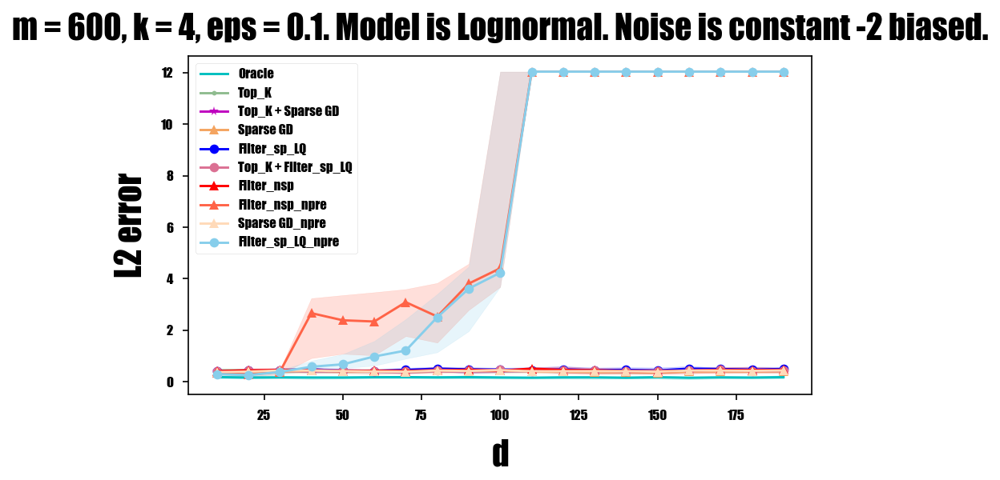

<Figure size 1200x600 with 0 Axes>

In [7]:
"loss vs dimension -- lognormal -- dense biased -- plot"

il.reload(rl)

trials = 50

m, k, eps = 600, 4, 0.1
xs = list(np.arange(10, 200, 10))

keys = [rl.Oracle, rl.Top_K, rl.Topk_GD, rl.GDAlgs, rl.RME_sp, rl.Top_K_Filtered, rl.RME, rl.RME_npre, rl.GDAlgs_npre, rl.RME_sp_npre]

model = rl.LognormalModel()
noise_model = rl.DenseNoise(-2)
model_params = rl.Params(m = m, k = k, eps = eps)
inputfilename = 'data/loss-time-vs-dimension-lognormal.pkl'
outputfilename = 'figs/loss-vs-dimension-lognormal.pdf'

title = 'm = {m}, k = {k}, eps = {eps}. Model is Lognormal. Noise is constant -2 biased.'.format(m = m, k = k, eps = eps)
xlabel = 'd'
ylabel = 'L2 error'

plot_d_loss = rl.plot_data(model = model, noise_model = noise_model, params = model_params, loss = rl.err, keys = keys)

plot_d_loss.plotxy_fromfile(yscale = 'linear', outputfilename = outputfilename, filename = inputfilename, title = title, xlabel = xlabel, ylabel = ylabel, figsize = figsize, fsize = fsize, fpad = fpad, xs = xs, fontname = fontname)

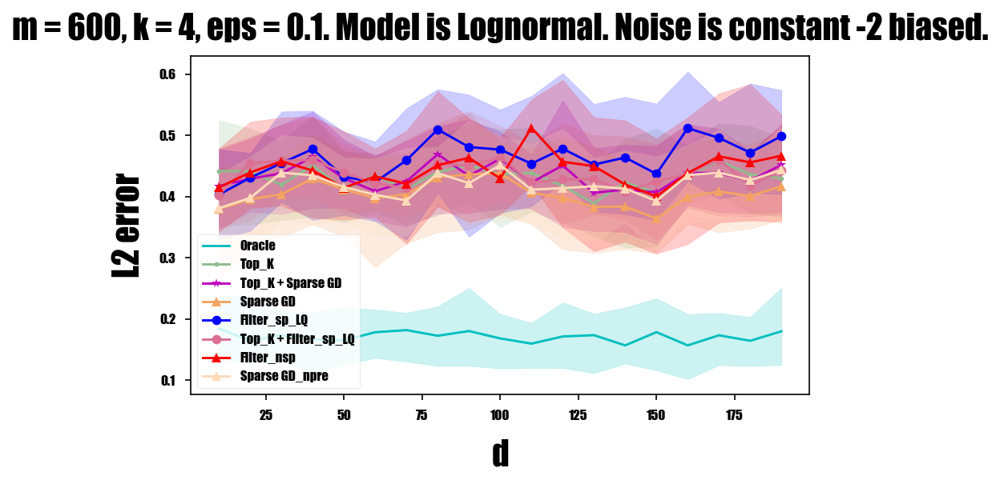

<Figure size 1200x600 with 0 Axes>

In [10]:
"loss vs dimension -- lognormal -- dense biased -- plot -- detailed"

il.reload(rl)

trials = 50

m, k, eps = 600, 4, 0.1
xs = list(np.arange(10, 200, 10))

keys = [rl.Oracle, rl.Top_K, rl.Topk_GD, rl.GDAlgs, rl.RME_sp, rl.Top_K_Filtered, rl.RME, rl.GDAlgs_npre]

model = rl.LognormalModel()
noise_model = rl.DenseNoise(-2)
model_params = rl.Params(m = m, k = k, eps = eps)
inputfilename = 'data/loss-time-vs-dimension-lognormal.pkl'
outputfilename = 'figs/loss-vs-dimension-lognormal-detailed.pdf'

title = 'm = {m}, k = {k}, eps = {eps}. Model is Lognormal. Noise is constant -2 biased.'.format(m = m, k = k, eps = eps)
xlabel = 'd'
ylabel = 'L2 error'

plot_d_loss = rl.plot_data(model = model, noise_model = noise_model, params = model_params, loss = rl.err, keys = keys)

plot_d_loss.plotxy_fromfile(outputfilename = outputfilename, filename = inputfilename, title = title, xlabel = xlabel, ylabel = ylabel, figsize = figsize, fsize = fsize, fpad = fpad, xs = xs, fontname = fontname)

In [9]:
"time vs dimension -- lognormal -- dense biased -- plot"

il.reload(rl)

trials = 50

m, k, eps = 600, 4, 0.1
xs = list(np.arange(10, 200, 10))

keys = [rl.Oracle, rl.Top_K, rl.Topk_GD, rl.GDAlgs, rl.RME_sp, rl.Top_K_Filtered, rl.RME, rl.RME_npre, rl.GDAlgs_npre, rl.RME_sp_npre]

model = rl.LognormalModel()
noise_model = rl.DenseNoise(-2)
model_params = rl.Params(m = m, k = k, eps = eps)

outputfilename = 'figs/time-vs-dimension-lognormal.pdf'
inputfilename = 'data/loss-time-vs-dimension-lognormal.pkl'
title = 'm = {m}, k = {k}, eps = {eps}. Model is Lognormal. Noise is constant -2 biased.'.format(m = m, k = k, eps = eps)
xlabel = 'd'
ylabel = 'Time'

plot_d_time = rl.plot_data(model = model, noise_model = noise_model, params = model_params, loss = rl.err, keys = keys)

plot_d_time.plotxy_fromfile_time(outputfilename = outputfilename, filename = inputfilename, title = title, xlabel = xlabel, ylabel = ylabel, figsize = figsize, fsize = fsize, fpad = fpad, xs = xs, fontname = fontname)

Oracle_time
[[0.01617908 0.00166106 0.00144601 0.00166702 0.00178981 0.00173211
  0.00166082 0.00146794 0.00148773 0.00152802 0.001472   0.00155807
  0.00160098 0.00159001 0.00162911 0.00163674 0.00169492 0.00173402
  0.00179291]
 [0.00143075 0.00259233 0.0015111  0.00189304 0.00216293 0.00278401
  0.00192094 0.00155687 0.00152588 0.00150394 0.00144792 0.00155711
  0.00169086 0.00169206 0.00162101 0.00166202 0.00164509 0.00189519
  0.00161195]
 [0.00176597 0.00197697 0.00227284 0.00217605 0.00222397 0.00144076
  0.00169587 0.00147104 0.00150108 0.00151896 0.00230289 0.00159264
  0.00200868 0.00160313 0.00165462 0.00186682 0.00185204 0.00193405
  0.00171304]
 [0.00172114 0.00234604 0.00261831 0.00222516 0.00312614 0.00165224
  0.00197673 0.00157809 0.00164413 0.00152707 0.00158477 0.00160837
  0.00156164 0.00187516 0.0016439  0.00178409 0.00163698 0.00199103
  0.00180984]
 [0.00158811 0.00174117 0.00184703 0.00176501 0.00192785 0.00254226
  0.00156903 0.00154281 0.00153184 0.00155067 0.

KeyError: 'Oracle_time'

Oracle_time
[[0.00212216 0.00144887 0.00167394 0.00150108 0.00151777 0.00156426
  0.00216198 0.00175691 0.00246406 0.00198984 0.00212097 0.00620604
  0.00161505 0.00169683 0.00166678 0.00162506 0.0022912  0.00175118
  0.00172496]
 [0.0020349  0.00194621 0.00208998 0.00177574 0.00180101 0.00150013
  0.0020299  0.001863   0.00167203 0.00167513 0.00167799 0.00168204
  0.00172305 0.00167298 0.00183511 0.00165677 0.00170612 0.0017302
  0.00171614]
 [0.00198913 0.00164199 0.00157905 0.00241208 0.00156116 0.00208712
  0.00222588 0.00187612 0.00158    0.00168204 0.00163579 0.00151229
  0.001791   0.00172091 0.001827   0.00169182 0.00156522 0.00216603
  0.00179505]
 [0.00177193 0.00178695 0.00250196 0.00146008 0.00153804 0.00176907
  0.00220704 0.00219393 0.00162387 0.00241995 0.00209904 0.00169015
  0.00164008 0.00187612 0.00196886 0.00211596 0.00191307 0.00185895
  0.00206065]
 [0.001333   0.00156808 0.00186205 0.00192308 0.00159621 0.00155091
  0.00238228 0.00223804 0.0018568  0.00157523 0.0

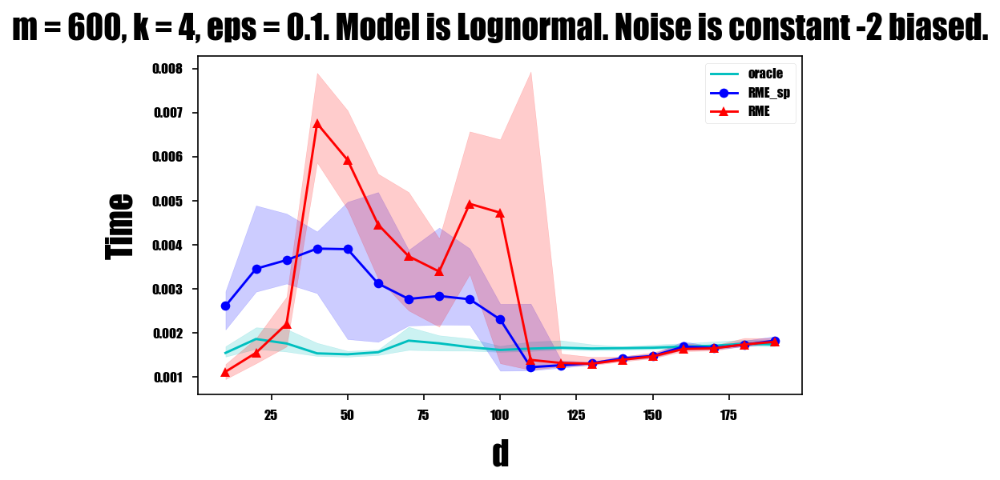

<Figure size 1200x600 with 0 Axes>

In [39]:
"time vs dimension -- lognormal -- dense biased -- plot -- detailed"

il.reload(rl)

trials = 50

m, k, eps = 600, 4, 0.1
xs = list(np.arange(10, 200, 10))

keys = [rl.Oracle, rl.RME_sp, rl.RME]

model = rl.LognormalModel()
noise_model = rl.DenseNoise(-2)
model_params = rl.Params(m = m, k = k, eps = eps)

outputfilename = 'figs/time-vs-dimension-lognormal-detailed.pdf'
inputfilename = 'data/loss-time-vs-dimension-lognormal.pkl'
title = 'm = {m}, k = {k}, eps = {eps}. Model is Lognormal. Noise is constant -2 biased.'.format(m = m, k = k, eps = eps)
xlabel = 'd'
ylabel = 'Time'

plot_d_time = rl.plot_data(model = model, noise_model = noise_model, params = model_params, loss = rl.err, keys = keys)

plot_d_time.plotxy_fromfile_time(outputfilename = outputfilename, filename = inputfilename, title = title, xlabel = xlabel, ylabel = ylabel, figsize = figsize, fsize = fsize, fpad = fpad, xs = xs, fontname = fontname)

In [11]:
"loss, time vs sparsity -- lognormal -- dense biased -- set data"

il.reload(rl)

trials = 50

m, d, eps = 600, 100, 0.1
xs = list(np.arange(4, 100, 4))

keys = [rl.Oracle, rl.Top_K, rl.Topk_GD, rl.GDAlgs, rl.RME_sp, rl.Top_K_Filtered, rl.RME, rl.RME_npre, rl.GDAlgs_npre, rl.RME_sp_npre]

model = rl.LognormalModel()
noise_model = rl.DenseNoise(-2)
model_params = rl.Params(m = m, d = d, eps = eps)

inputfilename = 'data/loss-time-vs-sparsity-lognormal.pkl'
plot_k = rl.load_data(model = model, noise_model = noise_model, params = model_params, loss = rl.err, keys = keys)
plot_k.setdata_tofile(filename = inputfilename, xvar_name = 'k', trials = trials, xs = xs)

[2. 2. 2. 2. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0.]
[[-0.71448845  2.42988554  2.70422126 ... -0.4462275  -1.2978771
  -1.02620642]
 [ 2.56331368  1.49512359  2.30718757 ... -0.70933499 -0.91568789
  -2.1585472 ]
 [ 3.23335041  1.34847953  2.55579838 ... -4.12749001 -0.91891811
  -2.57711163]
 ...
 [ 0.42009776 -2.22679966  2.2070509  ...  3.56331124 -8.03387366
  -6.61601086]
 [ 0.46781099 -0.09620721 -1.03076815 ... -2.72114217 -2.86850332
  -0.93262957]
 [ 0.61588589  0.28569387  2.98669615 ...  2.68524711 -4.73157374
  -3.12317445]]
m = {m} change to K = {K}
Prediction: [0, 1, 2, 3]
Prediction: [0, 1, 2, 3, 13, 17, 22, 23, 24, 29, 30, 33, 34, 35, 38, 41, 48, 51, 61, 62, 67, 71, 75, 78, 79, 81, 83, 88, 90, 95, 96]
m = {m} change to K

/Users/chenruidemac/Documents/GitHub/Robust_mean_estimation/robust_mean_estimate.py:421: RuntimeWarning: invalid value encountered in double_scalars
  f"Filtered out {l - len(idx[0])}/{l}, {bad_filtered} false ({bad_filtered / (l - len(idx[0])):0.2f} vs {self.fdr})")
/Users/chenruidemac/Documents/GitHub/Robust_mean_estimation/robust_mean_estimate.py:439: RuntimeWarning: invalid value encountered in double_scalars
  f"Filtered out {l - len(idx[0])}/{l}, {bad_filtered} false ({bad_filtered / (l - len(idx[0])):0.2f} vs {self.fdr})")


Prediction: [0, 1, 2, 3]
Linear filter...
Filtered out 0/114, 0.0 false (nan vs 0.1)
Quadratic filter...
Filtered out 0/114, 0.0 false (nan vs 0.1)
condition 114 114
Could not filter
m = {m} change to K = {K}
Linear filter...
Filtered out 0/64, 0.0 false (nan vs 0.1)
Could not filter
Linear filter...
Filtered out 0/2, 0.0 false (nan vs 0.1)
Could not filter
Time to run GD  0.6052830219268799
Linear filter...
Filtered out 0/2, 0.0 false (nan vs 0.1)
Quadratic filter...
Filtered out 0/2, 0.0 false (nan vs 0.1)
condition 2 2
Could not filter
[2. 2. 2. 2. 2. 2. 2. 2. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0.]
[[ 1.33802884  2.91995765  1.84888809 ...  0.19647848  3.65938215
  -0.71125555]
 [ 5.25144484  5.22525937  1.20582186 ... -0.3514448  -1.71780348
  

/Users/chenruidemac/Documents/GitHub/Robust_mean_estimation/robust_mean_estimate.py:396: RuntimeWarning: divide by zero encountered in true_divide
  return 8*np.exp(-T**2/2) + 8*eps/((T**2)*np.log(d*np.log(d/eps*tau)))


Time to run GD  0.1852421760559082
Linear filter...
Filtered out 0/3, 0.0 false (nan vs 0.1)
Quadratic filter...
Filtered out 0/3, 0.0 false (nan vs 0.1)
condition 3 3
Could not filter
[2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0.]
[[ 1.70763338  3.80312098 13.25021503 ...  0.79890478 -2.03786258
   0.86857903]
 [ 1.22419655  3.17957479 14.11893504 ... -0.80329185 -0.96640319
   0.32925886]
 [ 1.08911502  2.89849955 -0.34995935 ...  1.94629585 -1.80799808
  -0.33891504]
 ...
 [-1.91722535 -2.00067524  4.41060046 ... -2.30852134 -0.79463879
  -1.02584657]
 [ 3.34839947 -0.85725256 -1.52564951 ...  1.13972441 -2.23324306
  -1.36086553]
 [-2.51362864  0.37666973  4.88201678 ...  5.0234775   0.0270093
  -2.5650361 ]]
m = {m} change to 

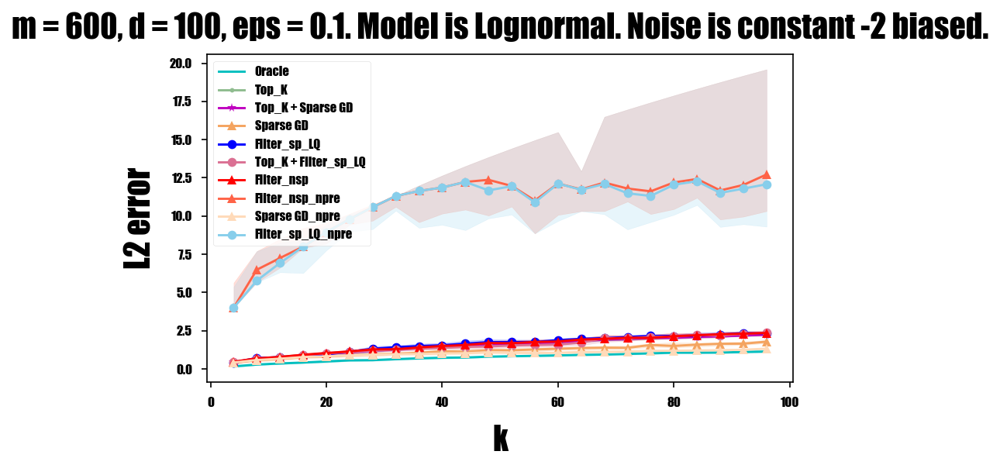

<Figure size 1200x600 with 0 Axes>

In [12]:
"loss vs sparsity -- lognormal -- dense biased -- plot"

il.reload(rl)

trials = 50

m, d, eps = 600, 100, 0.1
xs = list(np.arange(4, 100, 4))

keys = [rl.Oracle, rl.Top_K, rl.Topk_GD, rl.GDAlgs, rl.RME_sp, rl.Top_K_Filtered, rl.RME, rl.RME_npre, rl.GDAlgs_npre, rl.RME_sp_npre]

model = rl.LognormalModel()
noise_model = rl.DenseNoise(-2)
model_params = rl.Params(m = m, d = d, eps = eps)
inputfilename = 'data/loss-time-vs-sparsity-lognormal.pkl'
outputfilename = 'figs/loss-vs-sparsity-lognormal.pdf'

title = 'm = {m}, d = {d}, eps = {eps}. Model is Lognormal. Noise is constant -2 biased.'.format(m = m, d = d, eps = eps)
xlabel = 'k'
ylabel = 'L2 error'

plot_k_loss = rl.plot_data(model = model, noise_model = noise_model, params = model_params, loss = rl.err, keys = keys)

plot_k_loss.plotxy_fromfile(outputfilename = outputfilename, filename = inputfilename, title = title, xlabel = xlabel, ylabel = ylabel, figsize = figsize, fsize = fsize, fpad = fpad, xs = xs, fontname = fontname)

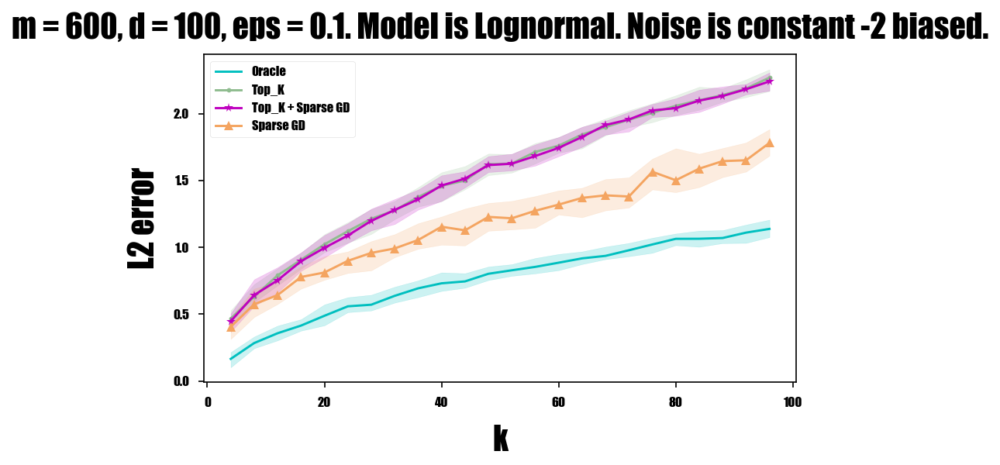

<Figure size 1200x600 with 0 Axes>

In [13]:
"loss vs sparsity -- lognormal -- dense biased -- plot -- detailed"

il.reload(rl)

trials = 50

m, d, eps = 600, 100, 0.1
xs = list(np.arange(4, 100, 4))

keys = [rl.Oracle, rl.Top_K, rl.Topk_GD, rl.GDAlgs]

model = rl.LognormalModel()
noise_model = rl.DenseNoise(-2)
model_params = rl.Params(m = m, d = d, eps = eps)
inputfilename = 'data/loss-time-vs-sparsity-lognormal.pkl'
outputfilename = 'figs/loss-vs-sparsity-lognormal-detailed.pdf'

title = 'm = {m}, d = {d}, eps = {eps}. Model is Lognormal. Noise is constant -2 biased.'.format(m = m, d = d, eps = eps)
xlabel = 'k'
ylabel = 'L2 error'

plot_k_loss = rl.plot_data(model = model, noise_model = noise_model, params = model_params, loss = rl.err, keys = keys)

plot_k_loss.plotxy_fromfile(outputfilename = outputfilename, filename = inputfilename, title = title, xlabel = xlabel, ylabel = ylabel, figsize = figsize, fsize = fsize, fpad = fpad, xs = xs, fontname = fontname)

Oracle_time
[[0.00248504 0.00184703 0.0022161  ... 0.00193882 0.00215101 0.00174999]
 [0.00157595 0.00183773 0.00176716 ... 0.00166035 0.00158525 0.00158811]
 [0.00171494 0.00157213 0.00152302 ... 0.00150681 0.00153708 0.00161386]
 ...
 [0.00155783 0.00160289 0.00153184 ... 0.00161099 0.00219512 0.00176835]
 [0.00185204 0.0015552  0.001683   ... 0.00176001 0.00148082 0.00161004]
 [0.00164032 0.00164986 0.00162983 ... 0.00155616 0.001616   0.00162578]]
Top_K_time
[[0.55477786 0.54081392 0.53559899 ... 0.5091908  0.50971293 0.51047182]
 [0.51017332 0.50860095 0.51455188 ... 0.51263309 0.50848699 0.51035881]
 [0.50531292 0.51648998 0.50765395 ... 0.5060041  0.50645399 0.50371933]
 ...
 [0.5358839  0.53390598 0.55503416 ... 0.5202322  0.51405287 0.51702404]
 [0.54991293 0.51430774 0.51898003 ... 0.51921892 0.51460814 0.51448607]
 [0.51866293 0.51676583 0.515697   ... 0.51721811 0.51445985 0.51649404]]
Topk_GD_time
[[1.01610231 0.24273014 0.24347591 ... 1.00693798 0.98374295 1.00864601]
 [0

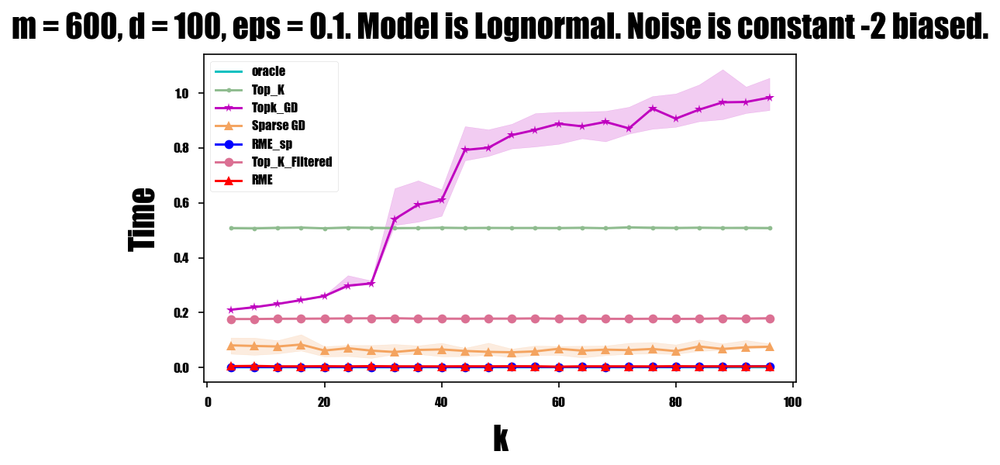

<Figure size 1200x600 with 0 Axes>

In [43]:
"time vs sparsity -- lognormal -- dense biased -- plot"

il.reload(rl)

trials = 50

m, d, eps = 600, 100, 0.1
xs = list(np.arange(4, 100, 4))

keys = [rl.Oracle, rl.Top_K, rl.Topk_GD, rl.GDAlgs, rl.RME_sp, rl.Top_K_Filtered, rl.RME]

model = rl.LognormalModel()
noise_model = rl.DenseNoise(-2)
model_params = rl.Params(m = m, d = d, eps = eps)
inputfilename = 'data/loss-time-vs-sparsity-lognormal.pkl'
outputfilename = 'figs/time-vs-sparsity-lognormal.pdf'

title = 'm = {m}, d = {d}, eps = {eps}. Model is Lognormal. Noise is constant -2 biased.'.format(m = m, d = d, eps = eps)
xlabel = 'k'
ylabel = 'Time'

plot_k_time = rl.plot_data(model = model, noise_model = noise_model, params = model_params, loss = rl.err, keys = keys)

plot_k_time.plotxy_fromfile_time(outputfilename = outputfilename, filename = inputfilename, title = title, xlabel = xlabel, ylabel = ylabel, figsize = figsize, fsize = fsize, fpad = fpad, xs = xs, fontname = fontname)

Oracle_time
[[0.00248504 0.00184703 0.0022161  ... 0.00193882 0.00215101 0.00174999]
 [0.00157595 0.00183773 0.00176716 ... 0.00166035 0.00158525 0.00158811]
 [0.00171494 0.00157213 0.00152302 ... 0.00150681 0.00153708 0.00161386]
 ...
 [0.00155783 0.00160289 0.00153184 ... 0.00161099 0.00219512 0.00176835]
 [0.00185204 0.0015552  0.001683   ... 0.00176001 0.00148082 0.00161004]
 [0.00164032 0.00164986 0.00162983 ... 0.00155616 0.001616   0.00162578]]
RME_sp_time
[[0.00702381 0.00248909 0.00107288 ... 0.00357699 0.00520706 0.0009973 ]
 [0.0010469  0.00111985 0.00237298 ... 0.00107408 0.00103307 0.00105405]
 [0.00233412 0.00372601 0.00120497 ... 0.00375199 0.00110984 0.00115204]
 ...
 [0.0011549  0.00107384 0.00228667 ... 0.00604916 0.00100803 0.00540805]
 [0.00213313 0.00228286 0.002846   ... 0.0010078  0.00104499 0.00472021]
 [0.00681782 0.0020721  0.00220799 ... 0.00449204 0.00724196 0.00687218]]
RME_time
[[0.01053619 0.00804877 0.00099182 ... 0.00433683 0.00595093 0.00120711]
 [0.00

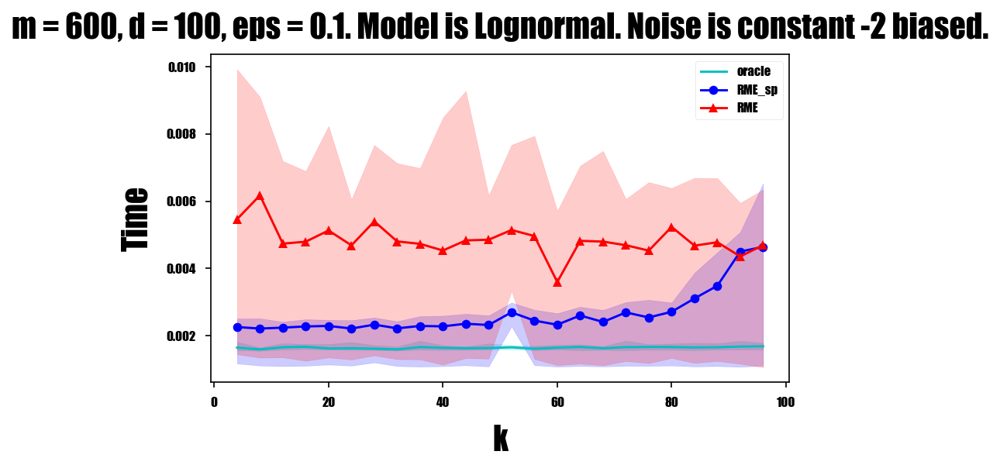

<Figure size 1200x600 with 0 Axes>

In [44]:
"time vs sparsity -- lognormal -- dense biased -- plot -- detailed"

il.reload(rl)

trials = 50

m, d, eps = 600, 100, 0.1
xs = list(np.arange(4, 100, 4))

keys = [rl.Oracle, rl.RME_sp, rl.RME]

model = rl.LognormalModel()
noise_model = rl.DenseNoise(-2)
model_params = rl.Params(m = m, d = d, eps = eps)
inputfilename = 'data/loss-time-vs-sparsity-lognormal.pkl'
outputfilename = 'figs/time-vs-sparsity-lognormal-detailed.pdf'

title = 'm = {m}, d = {d}, eps = {eps}. Model is Lognormal. Noise is constant -2 biased.'.format(m = m, d = d, eps = eps)
xlabel = 'k'
ylabel = 'Time'

plot_k_time = rl.plot_data(model = model, noise_model = noise_model, params = model_params, loss = rl.err, keys = keys)

plot_k_time.plotxy_fromfile_time(outputfilename = outputfilename, filename = inputfilename, title = title, xlabel = xlabel, ylabel = ylabel, figsize = figsize, fsize = fsize, fpad = fpad, xs = xs, fontname = fontname)

In [14]:
"loss, time vs sample -- lognormal -- dense biased -- set data"

il.reload(rl)

trials = 50

d, k, eps = 100, 4, 0.1
xs = list(np.arange(50, 1000, 50))

keys = [rl.Oracle, rl.Top_K, rl.Topk_GD, rl.GDAlgs, rl.RME_sp, rl.Top_K_Filtered, rl.RME, rl.RME_npre, rl.GDAlgs_npre, rl.RME_sp_npre]

model = rl.LognormalModel()
noise_model = rl.DenseNoise(-2)
model_params = rl.Params(d = d, k = k, eps = eps)

inputfilename = 'data/loss-time-vs-sample-lognormal.pkl'
plot_m = rl.load_data(model = model, noise_model = noise_model, params = model_params, loss = rl.err, keys = keys)
plot_m.setdata_tofile(filename = inputfilename, xvar_name = 'm', trials = trials, xs = xs)

[10. -5. -4.  2.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.]
[[ 7.55621589 -5.45654087 -2.75916555 ...  1.81248651  3.18920424
  -0.37939742]
 [ 9.18395535 -4.15960883 -3.61148646 ... -1.14606292 -0.80115467
   1.70880034]
 [12.91737901 -6.43254527 -4.44096025 ... -4.51695279  2.13485325
   2.53200727]
 ...
 [ 2.01055849 -6.36716808 -4.24435665 ... -2.5019932  -2.8175758
  -1.65558703]
 [ 9.3119466  -6.45342658 -5.68840277 ... -3.5589944   2.46388737
  -2.9380722 ]
 [ 7.07434673 -4.06524634 -4.63924023 ...  2.59705848 -3.26992038
  -2.16551301]]
m = {m} change to K = {K}
Prediction: [0, 1, 2, 3, 9, 10, 12, 15, 18, 24, 38, 39, 48, 61, 76, 85, 89, 

/Users/chenruidemac/Documents/GitHub/Robust_mean_estimation/robust_mean_estimate.py:421: RuntimeWarning: invalid value encountered in double_scalars
  f"Filtered out {l - len(idx[0])}/{l}, {bad_filtered} false ({bad_filtered / (l - len(idx[0])):0.2f} vs {self.fdr})")
/Users/chenruidemac/Documents/GitHub/Robust_mean_estimation/robust_mean_estimate.py:439: RuntimeWarning: invalid value encountered in double_scalars
  f"Filtered out {l - len(idx[0])}/{l}, {bad_filtered} false ({bad_filtered / (l - len(idx[0])):0.2f} vs {self.fdr})")


Linear filter...
Filtered out 3/7, 2.0 false (0.67 vs 0.1)


/Users/chenruidemac/Documents/GitHub/Robust_mean_estimation/robust_mean_estimate.py:396: RuntimeWarning: divide by zero encountered in true_divide
  return 8*np.exp(-T**2/2) + 8*eps/((T**2)*np.log(d*np.log(d/eps*tau)))


Linear filter...
Filtered out 2/4, 2.0 false (1.00 vs 0.1)
Linear filter...
Filtered out 0/2, 0.0 false (nan vs 0.1)
Could not filter
No points remaining.
Time to run GD  0.17281007766723633
No points remaining.
[10. -5. -4.  2.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.]
[[ 11.35502506  -5.77400678  -2.34316945 ...   0.92747582  -1.03233048
    1.11276356]
 [  9.26974294  -3.96795718  -3.87730578 ...  -1.87037734   5.18355602
    3.32944065]
 [  9.0482508  -10.80773418  -2.78316928 ...   0.60059345   0.9608718
    0.93823077]
 ...
 [  9.42298286  -4.29446574  -5.28894592 ...  -0.11757167  -0.25703165
   -6.23027245]
 [  8.35943937  -2.92003851  

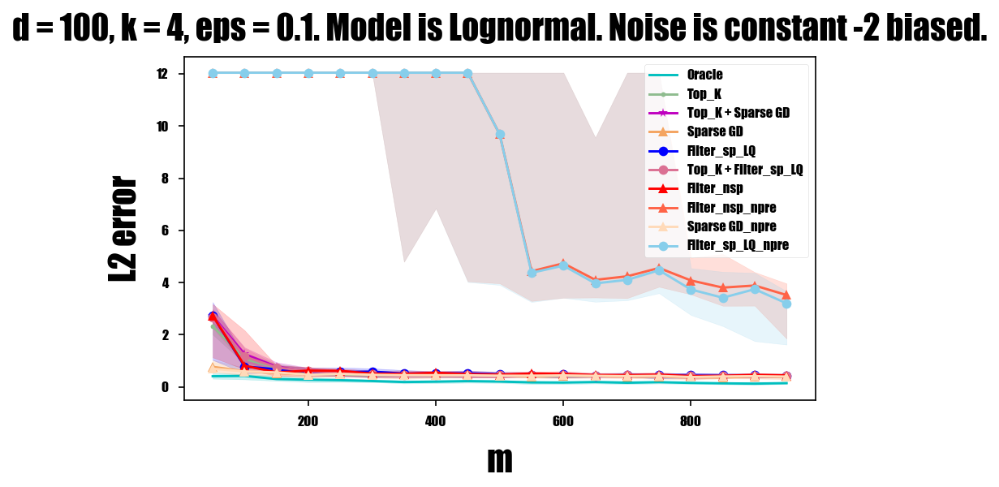

<Figure size 1200x600 with 0 Axes>

In [15]:
"loss vs sample -- lognormal -- dense biased -- plot"

il.reload(rl)

trials = 50

d, k, eps = 100, 4, 0.1
xs = list(np.arange(50, 1000, 50))

keys = [rl.Oracle, rl.Top_K, rl.Topk_GD, rl.GDAlgs, rl.RME_sp, rl.Top_K_Filtered, rl.RME, rl.RME_npre, rl.GDAlgs_npre, rl.RME_sp_npre]

model = rl.LognormalModel()
noise_model = rl.DenseNoise(-2)
model_params = rl.Params(d = d, k = k, eps = eps)
inputfilename = 'data/loss-time-vs-sample-lognormal.pkl'
outputfilename = 'figs/loss-vs-sample-lognormal.pdf'

title = 'd = {d}, k = {k}, eps = {eps}. Model is Lognormal. Noise is constant -2 biased.'.format(d = d, k = k, eps = eps)
xlabel = 'm'
ylabel = 'L2 error'

plot_m_loss = rl.plot_data(model = model, noise_model = noise_model, params = model_params, loss = rl.err, keys = keys)

plot_m_loss.plotxy_fromfile(outputfilename = outputfilename, filename = inputfilename, title = title, xlabel = xlabel, ylabel = ylabel, figsize = figsize, fsize = fsize, fpad = fpad, xs = xs, fontname = fontname)

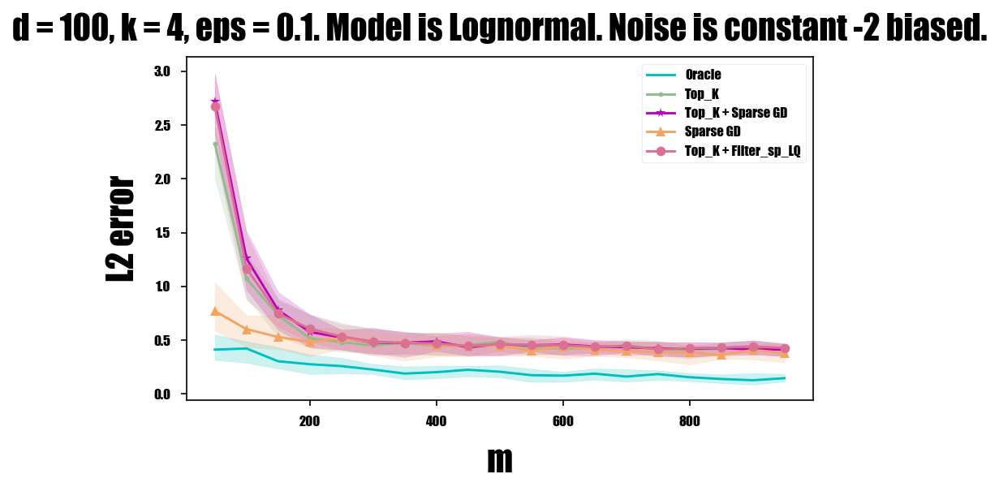

<Figure size 1200x600 with 0 Axes>

In [16]:
"loss vs sample -- lognormal -- dense biased -- plot -- detailed"

il.reload(rl)

trials = 50

d, k, eps = 100, 4, 0.1
xs = list(np.arange(50, 1000, 50))

keys = [rl.Oracle, rl.Top_K, rl.Topk_GD, rl.GDAlgs, rl.Top_K_Filtered]

model = rl.LognormalModel()
noise_model = rl.DenseNoise(-2)
model_params = rl.Params(d = d, k = k, eps = eps)
inputfilename = 'data/loss-time-vs-sample-lognormal.pkl'
outputfilename = 'figs/loss-vs-sample-lognormal-detailed.pdf'

title = 'd = {d}, k = {k}, eps = {eps}. Model is Lognormal. Noise is constant -2 biased.'.format(d = d, k = k, eps = eps)
xlabel = 'm'
ylabel = 'L2 error'

plot_m_loss = rl.plot_data(model = model, noise_model = noise_model, params = model_params, loss = rl.err, keys = keys)

plot_m_loss.plotxy_fromfile(outputfilename = outputfilename, filename = inputfilename, title = title, xlabel = xlabel, ylabel = ylabel, figsize = figsize, fsize = fsize, fpad = fpad, xs = xs, fontname = fontname)

Oracle_time
[[0.00219083 0.00226426 0.00224328 0.00143075 0.00214696 0.00119805
  0.00158381 0.00153303 0.00174904 0.00160074 0.00162411 0.00158262
  0.00159192 0.00168085 0.00161004 0.00178003 0.00175095 0.00211501
  0.00198984]
 [0.00117803 0.00223398 0.00190425 0.00213385 0.00307798 0.00131106
  0.00137687 0.00140405 0.001477   0.00145793 0.00152493 0.00166464
  0.00169277 0.00167394 0.00174403 0.00175023 0.00178313 0.00185108
  0.00188899]
 [0.00125098 0.00131512 0.00213885 0.00168872 0.0012641  0.00127792
  0.00153804 0.00129318 0.00146818 0.00152302 0.00155878 0.00162196
  0.00171518 0.00171971 0.0016818  0.00177717 0.00182796 0.00187612
  0.00195098]
 [0.00130916 0.00218701 0.00183702 0.0014112  0.00148773 0.00143695
  0.0013411  0.0013938  0.0014658  0.00144696 0.00153708 0.00164199
  0.00166583 0.00164986 0.00166416 0.00181818 0.00175524 0.00184298
  0.00194407]
 [0.00162387 0.00187922 0.00145102 0.00121093 0.0015111  0.00125909
  0.00142407 0.00130677 0.00149322 0.00154305 0.

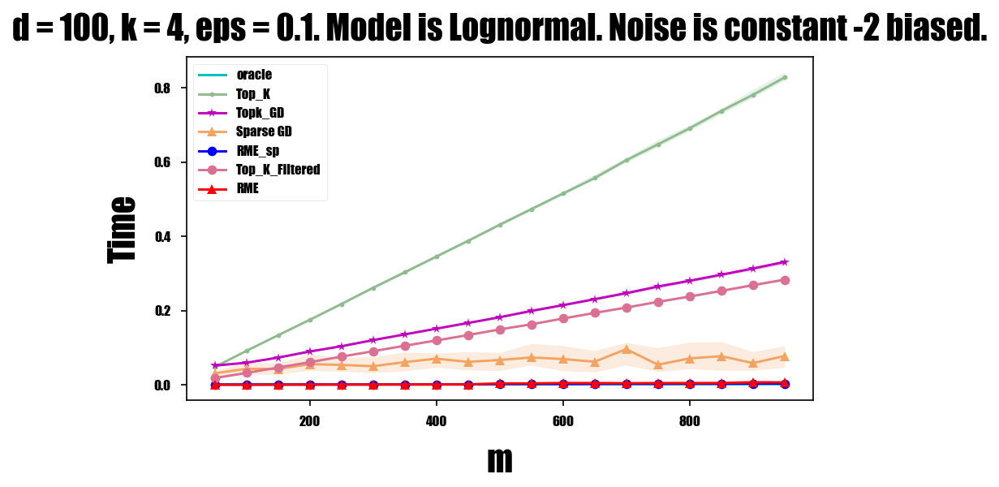

<Figure size 1200x600 with 0 Axes>

In [48]:
"time vs sample -- lognormal -- dense biased -- plot"

il.reload(rl)

trials = 50

d, k, eps = 100, 4, 0.1
xs = list(np.arange(50, 1000, 50))

keys = [rl.Oracle, rl.Top_K, rl.Topk_GD, rl.GDAlgs, rl.RME_sp, rl.Top_K_Filtered, rl.RME]

model = rl.LognormalModel()
noise_model = rl.DenseNoise(-2)
model_params = rl.Params(d = d, k = k, eps = eps)
inputfilename = 'data/loss-time-vs-sample-lognormal.pkl'
outputfilename = 'figs/time-vs-sample-lognormal.pdf'

title = 'd = {d}, k = {k}, eps = {eps}. Model is Lognormal. Noise is constant -2 biased.'.format(d = d, k = k, eps = eps)
xlabel = 'm'
ylabel = 'Time'

plot_m_time = rl.plot_data(model = model, noise_model = noise_model, params = model_params, loss = rl.err, keys = keys)

plot_m_time.plotxy_fromfile_time(outputfilename = outputfilename, filename = inputfilename, title = title, xlabel = xlabel, ylabel = ylabel, figsize = figsize, fsize = fsize, fpad = fpad, xs = xs, fontname = fontname)

Oracle_time
[[0.00219083 0.00226426 0.00224328 0.00143075 0.00214696 0.00119805
  0.00158381 0.00153303 0.00174904 0.00160074 0.00162411 0.00158262
  0.00159192 0.00168085 0.00161004 0.00178003 0.00175095 0.00211501
  0.00198984]
 [0.00117803 0.00223398 0.00190425 0.00213385 0.00307798 0.00131106
  0.00137687 0.00140405 0.001477   0.00145793 0.00152493 0.00166464
  0.00169277 0.00167394 0.00174403 0.00175023 0.00178313 0.00185108
  0.00188899]
 [0.00125098 0.00131512 0.00213885 0.00168872 0.0012641  0.00127792
  0.00153804 0.00129318 0.00146818 0.00152302 0.00155878 0.00162196
  0.00171518 0.00171971 0.0016818  0.00177717 0.00182796 0.00187612
  0.00195098]
 [0.00130916 0.00218701 0.00183702 0.0014112  0.00148773 0.00143695
  0.0013411  0.0013938  0.0014658  0.00144696 0.00153708 0.00164199
  0.00166583 0.00164986 0.00166416 0.00181818 0.00175524 0.00184298
  0.00194407]
 [0.00162387 0.00187922 0.00145102 0.00121093 0.0015111  0.00125909
  0.00142407 0.00130677 0.00149322 0.00154305 0.

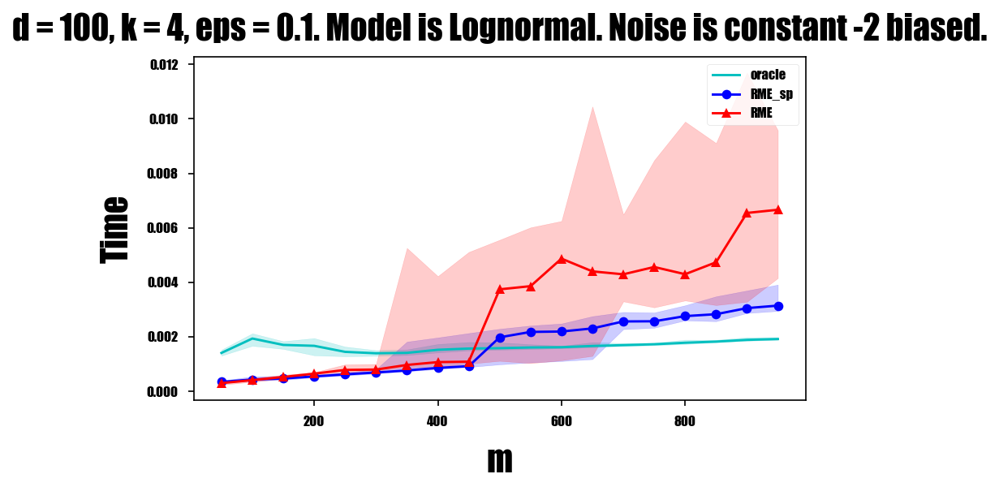

<Figure size 1200x600 with 0 Axes>

In [49]:
"time vs sample -- lognormal -- dense biased -- plot -- detailed"

il.reload(rl)

trials = 50

d, k, eps = 100, 4, 0.1
xs = list(np.arange(50, 1000, 50))

keys = [rl.Oracle, rl.RME_sp, rl.RME]

model = rl.LognormalModel()
noise_model = rl.DenseNoise(-2)
model_params = rl.Params(d = d, k = k, eps = eps)
inputfilename = 'data/loss-time-vs-sample-lognormal.pkl'
outputfilename = 'figs/time-vs-sample-lognormal-detailed.pdf'

title = 'd = {d}, k = {k}, eps = {eps}. Model is Lognormal. Noise is constant -2 biased.'.format(d = d, k = k, eps = eps)
xlabel = 'm'
ylabel = 'Time'

plot_m_time = rl.plot_data(model = model, noise_model = noise_model, params = model_params, loss = rl.err, keys = keys)

plot_m_time.plotxy_fromfile_time(outputfilename = outputfilename, filename = inputfilename, title = title, xlabel = xlabel, ylabel = ylabel, figsize = figsize, fsize = fsize, fpad = fpad, xs = xs, fontname = fontname)

In [17]:
"loss, time vs eps -- lognormal -- dense biased -- set data"

il.reload(rl)

trials = 50

d, k, m = 100, 4, 3000
xs = list(np.arange(0.01, 0.21, 0.01))

keys = [rl.Oracle, rl.Top_K, rl.Topk_GD, rl.GDAlgs, rl.RME_sp, rl.Top_K_Filtered, rl.RME, rl.RME_npre, rl.GDAlgs_npre, rl.RME_sp_npre]

model = rl.LognormalModel()
noise_model = rl.DenseNoise(-2)
model_params = rl.Params(d = d, k = k, m = m)

inputfilename = 'data/loss-time-vs-eps-lognormal.pkl'
plot_m = rl.load_data(model = model, noise_model = noise_model, params = model_params, loss = rl.err, keys = keys)
plot_m.setdata_tofile(filename = inputfilename, xvar_name = 'eps', trials = trials, xs = xs)

[10. -5. -4.  2.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.]
[[ 14.39447016  -5.81762823  -2.8932813  ...   3.20467093  -0.72143607
    0.27811929]
 [  9.06099627  -4.38934483  -2.04091959 ...   0.27665496   0.87177286
    1.74665191]
 [ 11.07028392  -4.36500065  -5.08324748 ...   2.47854251  -2.12027936
    0.48187125]
 ...
 [  7.01192832  -6.2198431   -5.50243114 ...  -3.16609927  -0.35351191
   -1.11564575]
 [  8.64402684 -12.2060848   -5.8285782  ...  -0.64629958   6.1732983
   -1.8536168 ]
 [  9.18622629  -7.73936502  -5.58548267 ...  -7.10160137  -6.51340877
   -1.14982705]]
m = {m} change to K = {K}
Prediction: [0, 1, 2, 3]
Prediction: [0,

/Users/chenruidemac/Documents/GitHub/Robust_mean_estimation/robust_mean_estimate.py:439: RuntimeWarning: invalid value encountered in double_scalars
  f"Filtered out {l - len(idx[0])}/{l}, {bad_filtered} false ({bad_filtered / (l - len(idx[0])):0.2f} vs {self.fdr})")


RME exited properly
Linear filter...
Filtered out 0/29, 0.0 false (nan vs 0.1)
Could not filter


/Users/chenruidemac/Documents/GitHub/Robust_mean_estimation/robust_mean_estimate.py:396: RuntimeWarning: divide by zero encountered in true_divide
  return 8*np.exp(-T**2/2) + 8*eps/((T**2)*np.log(d*np.log(d/eps*tau)))
/Users/chenruidemac/Documents/GitHub/Robust_mean_estimation/robust_mean_estimate.py:421: RuntimeWarning: invalid value encountered in double_scalars
  f"Filtered out {l - len(idx[0])}/{l}, {bad_filtered} false ({bad_filtered / (l - len(idx[0])):0.2f} vs {self.fdr})")


Time to run GD  0.6191701889038086
Linear filter...
Filtered out 8/29, 8.0 false (1.00 vs 0.1)
Linear filter...
Filtered out 5/21, 5.0 false (1.00 vs 0.1)
Linear filter...
Filtered out 6/16, 6.0 false (1.00 vs 0.1)
Linear filter...
Filtered out 6/10, 6.0 false (1.00 vs 0.1)
Linear filter...
Filtered out 2/4, 2.0 false (1.00 vs 0.1)
Linear filter...
Filtered out 0/2, 0.0 false (nan vs 0.1)
Quadratic filter...
Filtered out 0/2, 0.0 false (nan vs 0.1)
condition 2 2
Could not filter
[10. -5. -4.  2.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.]
[[ 9.48153809 -3.97028115 -5.11998045 ...  2.74464623  0.69962341
   0.95871615]
 [ 9.69834026 -4.01589813 -3

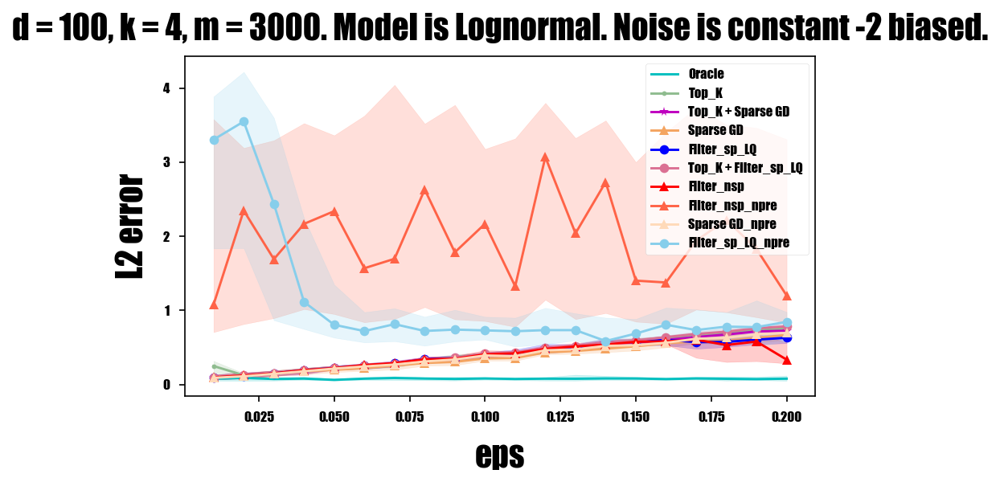

<Figure size 1200x600 with 0 Axes>

In [18]:
"loss vs eps -- lognormal -- dense biased -- plot"

il.reload(rl)

trials = 50

d, k, m = 100, 4, 3000
xs = list(np.arange(0.01, 0.21, 0.01))

keys = [rl.Oracle, rl.Top_K, rl.Topk_GD, rl.GDAlgs, rl.RME_sp, rl.Top_K_Filtered, rl.RME, rl.RME_npre, rl.GDAlgs_npre, rl.RME_sp_npre]

model = rl.LognormalModel()
noise_model = rl.DenseNoise(-2)
model_params = rl.Params(d = d, k = k, m = m)
inputfilename = 'data/loss-time-vs-eps-lognormal.pkl'
outputfilename = 'figs/loss-vs-eps-lognormal.pdf'

title = 'd = {d}, k = {k}, m = {m}. Model is Lognormal. Noise is constant -2 biased.'.format(d = d, k = k, m = m)
xlabel = 'eps'
ylabel = 'L2 error'

plot_eps_loss = rl.plot_data(model = model, noise_model = noise_model, params = model_params, loss = rl.err, keys = keys)

plot_eps_loss.plotxy_fromfile(outputfilename = outputfilename, filename = inputfilename, title = title, xlabel = xlabel, ylabel = ylabel, figsize = figsize, fsize = fsize, fpad = fpad, xs = xs, fontname = fontname)

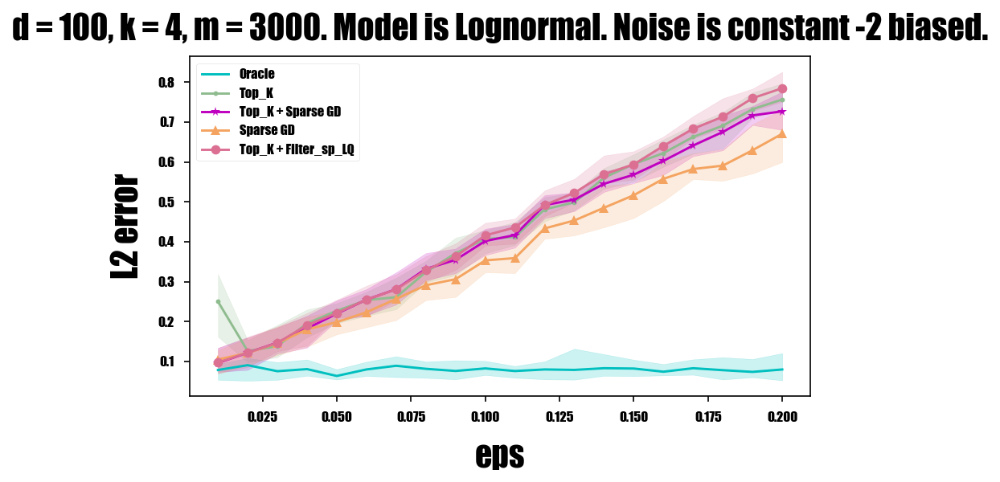

<Figure size 1200x600 with 0 Axes>

In [19]:
"loss vs eps -- lognormal -- dense biased -- plot -- detailed"

il.reload(rl)

trials = 50

d, k, m = 100, 4, 3000
xs = list(np.arange(0.01, 0.21, 0.01))

keys = [rl.Oracle, rl.Top_K, rl.Topk_GD, rl.GDAlgs, rl.Top_K_Filtered]

model = rl.LognormalModel()
noise_model = rl.DenseNoise(-2)
model_params = rl.Params(d = d, k = k, m = m)
inputfilename = 'data/loss-time-vs-eps-lognormal.pkl'
outputfilename = 'figs/loss-vs-eps-lognormal-detailed.pdf'

title = 'd = {d}, k = {k}, m = {m}. Model is Lognormal. Noise is constant -2 biased.'.format(d = d, k = k, m = m)
xlabel = 'eps'
ylabel = 'L2 error'

plot_eps_loss = rl.plot_data(model = model, noise_model = noise_model, params = model_params, loss = rl.err, keys = keys)

plot_eps_loss.plotxy_fromfile(outputfilename = outputfilename, filename = inputfilename, title = title, xlabel = xlabel, ylabel = ylabel, figsize = figsize, fsize = fsize, fpad = fpad, xs = xs, fontname = fontname)

Oracle_time
[[0.00266123 0.00254178 0.00441504 0.00169802 0.00213027 0.00217199
  0.00215602 0.00169516 0.00210404 0.00154591 0.00258207 0.00159001
  0.00165486 0.00149703 0.00177407 0.00193524 0.00185609 0.00152683
  0.0016849  0.00158119]
 [0.00157619 0.00175524 0.00159502 0.00187707 0.00221395 0.00174689
  0.00151491 0.00168395 0.00196886 0.00171995 0.001719   0.00160217
  0.00165415 0.00237489 0.00187993 0.00189114 0.00179911 0.00160003
  0.00161624 0.00144577]
 [0.00165081 0.0016048  0.00194716 0.00194287 0.0018239  0.00240612
  0.00167394 0.001616   0.00159311 0.00169086 0.00161791 0.00163817
  0.00169587 0.00173616 0.00188708 0.00189471 0.00174093 0.00151801
  0.0014739  0.00157905]
 [0.00465918 0.00201774 0.00155687 0.00162983 0.00167894 0.00164008
  0.00186491 0.00157619 0.00229192 0.00167084 0.00154495 0.00246572
  0.00145531 0.00168109 0.00159311 0.00152802 0.00172377 0.00154185
  0.00176716 0.00166082]
 [0.00166082 0.00183916 0.00157428 0.00163507 0.00160217 0.00192213
  0.

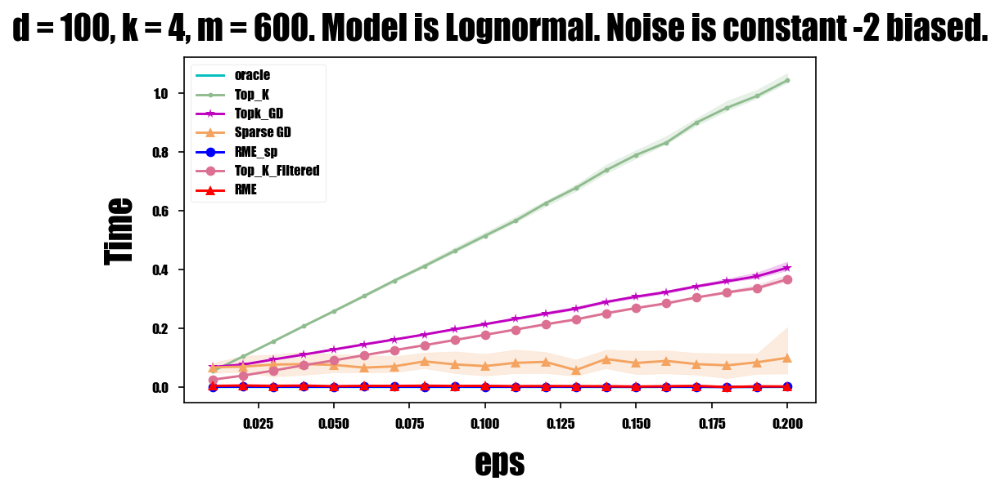

<Figure size 1200x600 with 0 Axes>

In [52]:
"time vs eps -- lognormal -- dense biased -- plot"

il.reload(rl)

trials = 50

d, k, m = 100, 4, 600
xs = list(np.arange(0.01, 0.21, 0.01))

keys = [rl.Oracle, rl.Top_K, rl.Topk_GD, rl.GDAlgs, rl.RME_sp, rl.Top_K_Filtered, rl.RME]

model = rl.LognormalModel()
noise_model = rl.DenseNoise(-2)
model_params = rl.Params(d = d, k = k, m = m)
inputfilename = 'data/loss-time-vs-eps-lognormal.pkl'
outputfilename = 'figs/time-vs-eps-lognormal.pdf'

title = 'd = {d}, k = {k}, m = {m}. Model is Lognormal. Noise is constant -2 biased.'.format(d = d, k = k, m = m)
xlabel = 'eps'
ylabel = 'Time'

plot_eps_time = rl.plot_data(model = model, noise_model = noise_model, params = model_params, loss = rl.err, keys = keys)

plot_eps_time.plotxy_fromfile_time(outputfilename = outputfilename, filename = inputfilename, title = title, xlabel = xlabel, ylabel = ylabel, figsize = figsize, fsize = fsize, fpad = fpad, xs = xs, fontname = fontname)

Oracle_time
[[0.00266123 0.00254178 0.00441504 0.00169802 0.00213027 0.00217199
  0.00215602 0.00169516 0.00210404 0.00154591 0.00258207 0.00159001
  0.00165486 0.00149703 0.00177407 0.00193524 0.00185609 0.00152683
  0.0016849  0.00158119]
 [0.00157619 0.00175524 0.00159502 0.00187707 0.00221395 0.00174689
  0.00151491 0.00168395 0.00196886 0.00171995 0.001719   0.00160217
  0.00165415 0.00237489 0.00187993 0.00189114 0.00179911 0.00160003
  0.00161624 0.00144577]
 [0.00165081 0.0016048  0.00194716 0.00194287 0.0018239  0.00240612
  0.00167394 0.001616   0.00159311 0.00169086 0.00161791 0.00163817
  0.00169587 0.00173616 0.00188708 0.00189471 0.00174093 0.00151801
  0.0014739  0.00157905]
 [0.00465918 0.00201774 0.00155687 0.00162983 0.00167894 0.00164008
  0.00186491 0.00157619 0.00229192 0.00167084 0.00154495 0.00246572
  0.00145531 0.00168109 0.00159311 0.00152802 0.00172377 0.00154185
  0.00176716 0.00166082]
 [0.00166082 0.00183916 0.00157428 0.00163507 0.00160217 0.00192213
  0.

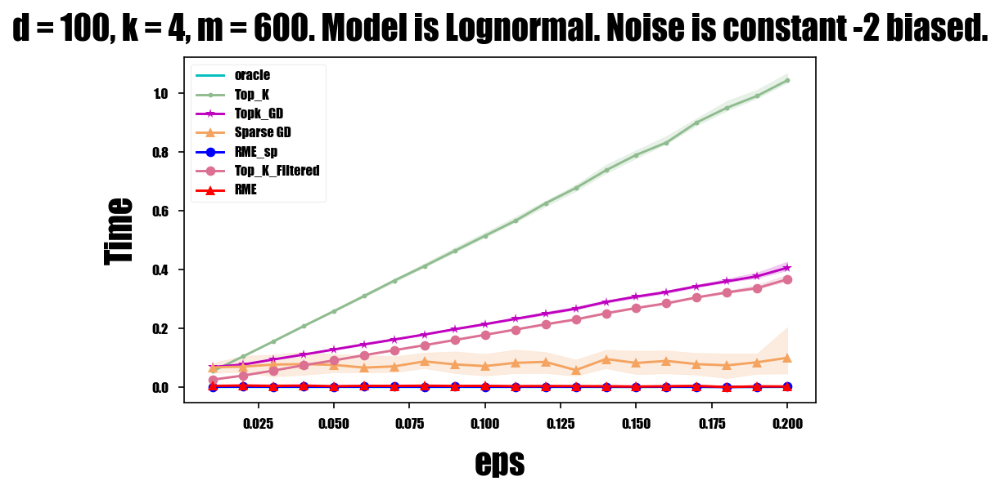

<Figure size 1200x600 with 0 Axes>

In [53]:
"time vs eps -- lognormal -- dense biased -- plot -- detailed"

il.reload(rl)

trials = 50

d, k, m = 100, 4, 600
xs = list(np.arange(0.01, 0.21, 0.01))

keys = [rl.Oracle, rl.Top_K, rl.Topk_GD, rl.GDAlgs, rl.RME_sp, rl.Top_K_Filtered, rl.RME]

model = rl.LognormalModel()
noise_model = rl.DenseNoise(-2)
model_params = rl.Params(d = d, k = k, m = m)
inputfilename = 'data/loss-time-vs-eps-lognormal.pkl'
outputfilename = 'figs/time-vs-eps-lognormal-detailed.pdf'

title = 'd = {d}, k = {k}, m = {m}. Model is Lognormal. Noise is constant -2 biased.'.format(d = d, k = k, m = m)
xlabel = 'eps'
ylabel = 'Time'

plot_eps_time = rl.plot_data(model = model, noise_model = noise_model, params = model_params, loss = rl.err, keys = keys)

plot_eps_time.plotxy_fromfile_time(outputfilename = outputfilename, filename = inputfilename, title = title, xlabel = xlabel, ylabel = ylabel, figsize = figsize, fsize = fsize, fpad = fpad, xs = xs, fontname = fontname)

In [25]:
"loss, time vs var -- lognormal -- dense biased -- set data"

il.reload(rl)

trials = 50

d, k, m, eps = 100, 4, 600, 0.1
xs = list(np.arange(0.1, 10.1, 0.1))

keys = [rl.Oracle, rl.Top_K, rl.Topk_GD, rl.GDAlgs, rl.RME_sp, rl.Top_K_Filtered, rl.RME, rl.RME_npre, rl.GDAlgs_npre, rl.RME_sp_npre]

model = rl.LognormalModel()
noise_model = rl.DenseNoise(-2)
model_params = rl.Params(d = d, k = k, m = m, eps = eps)

inputfilename = 'data/loss-time-vs-var-lognormal.pkl'
plot_var = rl.load_data(model = model, noise_model = noise_model, params = model_params, loss = rl.err, keys = keys)
plot_var.setdata_tofile(filename = inputfilename, xvar_name = 'var', trials = trials, xs = xs)

[10. -5. -4.  2.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.]
[[ 9.81926139 -5.09197898 -3.8722668  ...  0.41195962  0.23736841
  -0.03511841]
 [ 9.89790631 -5.02140312 -4.44262855 ...  0.01417949 -0.18094256
  -0.12222144]
 [ 9.83147693 -4.97842349 -4.02948045 ...  0.09837043 -0.06368422
   0.21809993]
 ...
 [ 7.91568291 -7.22622145 -5.57514111 ... -2.11707181 -2.16312708
  -2.15995815]
 [ 8.19132746 -7.71156257 -5.63178746 ... -2.13946832 -1.80537722
  -2.132249  ]
 [ 7.98946465 -7.02805739 -6.18253499 ... -1.93095893 -2.83443981
  -1.67728004]]
m = 600 change to K = 240
Prediction: [0, 1, 2, 3]
Prediction: [0, 1, 2, 3, 8, 9, 10, 12, 14, 15, 16,

/Users/chenruidemac/Documents/GitHub/Robust_mean_estimation/robust_mean_estimate.py:440: RuntimeWarning: invalid value encountered in double_scalars
  f"Filtered out {l - len(idx[0])}/{l}, {bad_filtered} false ({bad_filtered / (l - len(idx[0])):0.2f} vs {self.fdr})")


Prediction: [0, 1, 2, 3]
Quadratic filter...
Filtered out 0/240, 0.0 false (nan vs 0.1)
condition 240 240
Could not filter
m = 600 change to K = 240
Linear filter...
Filtered out 55/240, 0.0 false (0.00 vs 0.1)
RME exited properly
Linear filter...
Filtered out 60/595, 0.0 false (0.00 vs 0.1)
RME exited properly


/Users/chenruidemac/Documents/GitHub/Robust_mean_estimation/robust_mean_estimate.py:397: RuntimeWarning: divide by zero encountered in true_divide
  return 8*np.exp(-T**2/2) + 8*eps/((T**2)*np.log(d*np.log(d/eps*tau)))


Time to run GD  0.5625903606414795
Linear filter...
Filtered out 51/595, 0.0 false (0.00 vs 0.1)
Quadratic filter...
Filtered out 0/544, 0.0 false (nan vs 0.1)
condition 544 544
Could not filter
[10. -5. -4.  2.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.]
[[ 9.87212629 -4.91962465 -3.89779311 ... -0.62554313 -0.08146723
   0.94409658]
 [ 9.94864941 -5.27347441 -4.16785903 ...  0.24589191 -0.13213885
   0.38178146]
 [10.43062857 -5.21006233 -3.54226403 ... -0.0612458   0.07027481
  -0.11129931]
 ...
 [ 7.82567481 -6.6576521  -5.92512223 ... -1.37929824 -2.12011803
  -1.95616326]
 [ 7.93141292 -7.02180728 -5.87933652 ... -1.64139564 -2.25533801
  -

/Users/chenruidemac/Documents/GitHub/Robust_mean_estimation/robust_mean_estimate.py:422: RuntimeWarning: invalid value encountered in double_scalars
  f"Filtered out {l - len(idx[0])}/{l}, {bad_filtered} false ({bad_filtered / (l - len(idx[0])):0.2f} vs {self.fdr})")


[10. -5. -4.  2.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.]
[[10.52392573 -4.92420027 -4.08780278 ...  0.14571879  0.22797126
  -0.84201246]
 [ 8.64385563 -2.06407823 -3.63261831 ... -0.14809983  0.20226726
   0.52970318]
 [10.20790092 -5.03718062 -4.89674638 ...  0.35113721 -0.20952755
  -0.08163207]
 ...
 [ 8.14568132 -6.11678522 -6.52580728 ... -1.42302164 -1.94659602
  -1.94064128]
 [ 7.87010545 -6.92771243 -6.47794973 ... -1.79986751 -2.13274683
  -2.21000046]
 [ 8.15157142 -7.56316893 -5.93351219 ... -1.65141296 -1.8113913
  -1.73130747]]
m = 600 change to K = 240
Prediction: [0, 1, 2, 3]
Prediction: [0, 1, 2, 3, 4, 6, 7, 8, 9, 10, 13, 14,

AttributeError: 'XAxis' object has no attribute '_gridOnMajor'

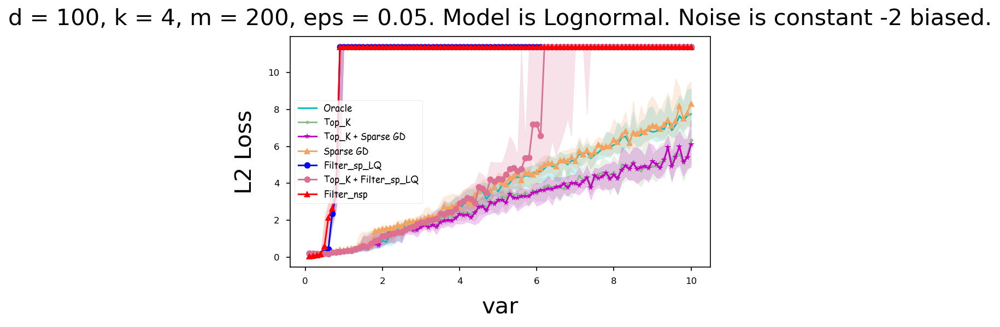

<Figure size 1200x600 with 0 Axes>

In [ ]:
"loss vs var -- lognormal -- dense biased -- plot"

il.reload(rl)

trials = 50

d, k, m, eps = 100, 4, 600, 0.1
xs = list(np.arange(0.1, 10.1, 0.1))

keys = [rl.Oracle, rl.Top_K, rl.Topk_GD, rl.GDAlgs, rl.RME_sp, rl.Top_K_Filtered, rl.RME, rl.RME_npre, rl.GDAlgs_npre, rl.RME_sp_npre]

model = rl.LognormalModel()
noise_model = rl.DenseNoise(-2)
model_params = rl.Params(d = d, k = k, m = m)
inputfilename = 'data/loss-time-vs-var-lognormal.pkl'
outputfilename = 'figs/loss-vs-var-lognormal.pdf'

title = 'd = {d}, k = {k}, m = {m}, eps = {eps}. Model is Lognormal. Noise is constant -2 biased.'.format(d = d, k = k, m = m, eps = eps)
xlabel = 'var'
ylabel = 'L2 error'

plot_var_loss = rl.plot_data(model = model, noise_model = noise_model, params = model_params, loss = rl.err, keys = keys)

plot_var_loss.plotxy_fromfile(outputfilename = outputfilename, filename = inputfilename, title = title, xlabel = xlabel, ylabel = ylabel, figsize = figsize, fsize = fsize, fpad = fpad, xs = xs, fontname = fontname)

In [ ]:
"loss vs var -- lognormal -- dense biased -- plot -- detailed"

il.reload(rl)

trials = 50

d, k, m, eps = 100, 4, 600, 0.1
xs = list(np.arange(0.1, 10.1, 0.1))

keys = [rl.Oracle, rl.Top_K, rl.Topk_GD, rl.GDAlgs, rl.RME_sp, rl.Top_K_Filtered, rl.RME, rl.RME_npre, rl.GDAlgs_npre, rl.RME_sp_npre]

model = rl.LognormalModel()
noise_model = rl.DenseNoise(-2)
model_params = rl.Params(d = d, k = k, m = m)
inputfilename = 'data/loss-time-vs-var-lognormal.pkl'
outputfilename = 'figs/loss-vs-var-lognormal-detailed.pdf'

title = 'd = {d}, k = {k}, m = {m}, eps = {eps}. Model is Lognormal. Noise is constant -2 biased.'.format(d = d, k = k, m = m, eps = eps)
xlabel = 'var'
ylabel = 'L2 Loss'

plot_eps_loss = rl.plot_data(model = model, noise_model = noise_model, params = model_params, loss = rl.err, keys = keys)

plot_eps_loss.plotxy_fromfile(outputfilename = outputfilename, filename = inputfilename, title = title, xlabel = xlabel, ylabel = ylabel, figsize = figsize, fsize = fsize, fpad = fpad, xs = xs, fontname = fontname)